In [1]:
import h5py
import matplotlib
import numpy as np
import sys
from matplotlib import pyplot as plt

import astropy.units as u
import pandas as pd
from astropy.table import Table, Column, join

sys.path.insert(1, '/home/ksf293/anomalies-GAN-HSC/analysis')
import utils
import plotter

%load_ext autoreload
%autoreload 2

In [2]:
import matplotlib
from matplotlib import pylab
from matplotlib.ticker import FormatStrFormatter

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
matplotlib.rcParams['figure.dpi'] = 200
params = {'legend.fontsize': 'xx-large',
          'figure.figsize': (6, 4),
         'axes.labelsize': 'xx-large',
         'axes.titlesize': 'xx-large',
         'xtick.labelsize': 'xx-large',
         'ytick.labelsize': 'xx-large',
         'font.family': 'sans-serif',
         'text.usetex': True}
pylab.rcParams.update(params)

In [3]:
#plot_dir = '/home/ksf293/anomalies-GAN-HSC/plots/plots_2021-07-13'
plot_dir = '/home/ksf293/anomalies-GAN-HSC/papers/paper_main/images'

In [4]:
#imtag = 'gri_lambda0.3_3sigd'
#tag = 'gri_lambda0.3_3sigd'
#aenum = 10000
#imtag = 'gri_1k'
#tag = 'gri_1k_lambda0.3'
#aenum = 1000
imtag = 'gri'
tag = 'gri_lambda0.3'
aenum = 30000
mode = 'reals'
aetag = f'_latent64_{mode}_long_lr1e-4'
savetag = f'_model{aenum}{aetag}'
base_dir = '/scratch/ksf293/anomalies'
results_dir = f'{base_dir}/results'
results_ae_fn = f'{results_dir}/results_aefull_{tag}{savetag}.h5'
results_fn = f'{results_dir}/results_{tag}.h5'
imarr_fn = f'{base_dir}/data/images_h5/images_{imtag}.h5'

In [5]:
imdict_fn = f'{base_dir}/data/idxdicts_h5/idx2imloc_{imtag}.npy'
resdict_fn = f'{base_dir}/data/idxdicts_h5/idx2resloc_{tag}.npy'
idx2imloc = np.load(imdict_fn, allow_pickle=True).item()
idx2resloc = np.load(resdict_fn, allow_pickle=True).item()

In [6]:
aeres = h5py.File(results_ae_fn, 'r')
res = h5py.File(results_fn, 'r')
imarr = h5py.File(imarr_fn, 'r')

## AE reconstructions

In [7]:
def plot_ae_recons(ids, res, score_name='ae_anomaly_scores_sigma', 
                   score_label='$s_\mathrm{{CAE}}$', saveto=None, border_color=None):
    nims = len(ids)
    subsize = 2
    fig, axarr = plt.subplots(3,nims,figsize=(nims*subsize,3*subsize), edgecolor=border_color)
    plt.subplots_adjust(hspace=0.02, wspace=0.1)
    count = 0
    for i in range(nims):
        idx = ids[i]
        
        loc = idx2imloc[idx]
        #im = luptonize(imarr['images'][loc])
        
        
        rloc = idx2resloc[idx]
        im = res['reals'][rloc]
        recon = res['decodeds'][rloc]
        score = float(res[score_name][rloc])
        obj_id = res['object_ids'][rloc]
        #resid = get_residual(im, recon)
        resid = res['residuals'][rloc]
        
        ax0 = axarr[0][i]
        ax1 = axarr[1][i]
        ax2 = axarr[2][i]
        
        sigma = ''
        if 'sigma' in score_name:
            sigma = '$\sigma$'
        ax0.text(96/2, -24, f"ID {obj_id}", ha='center', fontsize=10.5)
        ax0.text(96/2, -8, f"{score_label} = {score:.2f}{sigma}", ha='center', fontsize=14)
#         title = r'''ID: {}
# {} = {:.2f}{}'''.format(obj_id, score_label, score, sigma)
#         ax0.set_title(title, fontsize=8)
        ax0.imshow(im)
        ax1.imshow(recon)
        ax2.imshow(resid)
        
        if i==0:
            fsize=15
            ax0.set_ylabel("real",fontsize=fsize)
            ax1.set_ylabel("AE decoded",fontsize=fsize)
            ax2.set_ylabel("residual",fontsize=fsize)
        
        for ax in [ax0, ax1, ax2]:
            ax.set_xticks([])
            ax.set_yticks([])
    
    if border_color is not None:
        fig.patch.set_edgecolor(border_color)  
        fig.patch.set_linewidth('4') 
        
    if saveto:
        plt.savefig(saveto, bbox_inches='tight', edgecolor=border_color)#, pad_inches=0)

In [8]:
def plot_recons(ids, res, score_name='ae_anomaly_scores_sigma', 
                   score_label='$s_\mathrm{{CAE}}$', saveto=None, border_color=None):
    nims = len(ids)
    subsize = 2
    fig, axarr = plt.subplots(3,nims,figsize=(nims*subsize,3*subsize), edgecolor=border_color)
    plt.subplots_adjust(hspace=0.02, wspace=0.1)
    count = 0
    for i in range(nims):
        idx = ids[i]
        
        loc = idx2imloc[idx]
        #im = luptonize(imarr['images'][loc])
        
        
        rloc = idx2resloc[idx]
        im = res['reals'][rloc]
        recon = res['reconstructed'][rloc]
        score = float(res[score_name][rloc])
        obj_id = res['object_ids'][rloc]
        #resid = get_residual(im, recon)
        resid = res['residuals'][rloc]
        
        ax0 = axarr[0][i]
        ax1 = axarr[1][i]
        ax2 = axarr[2][i]
        sigma = ''
        if 'sigma' in score_name:
            sigma = '$\sigma$'
        ax0.text(96/2, -24, f"ID {obj_id}", ha='center', fontsize=10.5)
        ax0.text(96/2, -8, f"{score_label} = {score:.2f}{sigma}", ha='center', fontsize=14)
#         title = r'''ID: {}
# {} = {:.2f}{}'''.format(obj_id, score_label, score, sigma)
#         ax0.set_title(title, fontsize=8)
        ax0.imshow(im)
        ax1.imshow(recon)
        ax2.imshow(resid)
        
        if i==0:
            fsize=15
            ax0.set_ylabel("real",fontsize=fsize)
            ax1.set_ylabel("reconstructed",fontsize=fsize)
            ax2.set_ylabel("residual",fontsize=fsize)
        
        for ax in [ax0, ax1, ax2]:
            ax.set_xticks([])
            ax.set_yticks([])
    
    if border_color is not None:
        fig.patch.set_edgecolor(border_color)  
        fig.patch.set_linewidth('4') 
        
    if saveto:
        plt.savefig(saveto, bbox_inches='tight', edgecolor=border_color)#, pad_inches=0)

## Recon figures

In [9]:
imtag = 'gri'
tag = 'gri_lambda0.3'
results_fn = f'{base_dir}/results/results_{tag}.h5'
res = h5py.File(results_fn, 'r')
scores = res['anomaly_scores_sigma'][:]
idxs = res['idxs'][:]
n_recons = 3

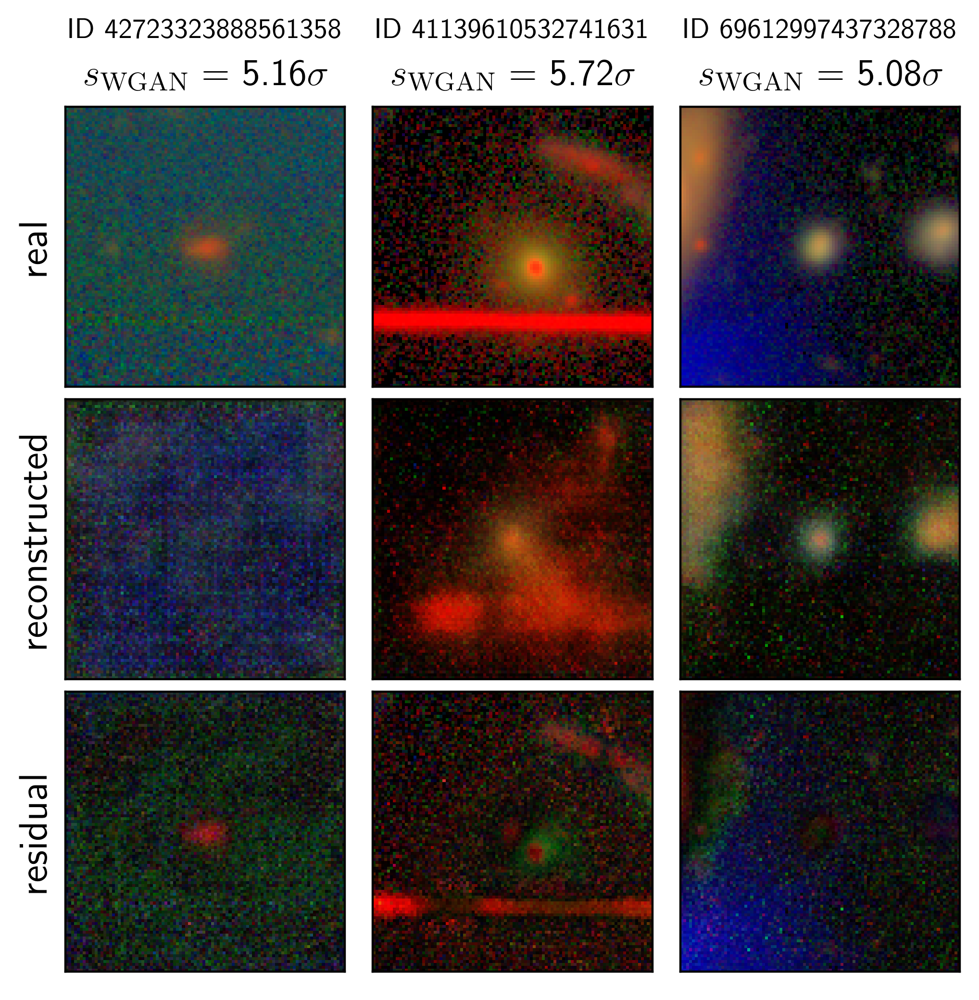

In [10]:
smin, smax = 5, 20
np.random.seed(43) #41
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plot_recons(idxs_recon, res, saveto=f'{plot_dir}/recons_{smin}to{smax}sigcomb.png',
                    score_name='anomaly_scores_sigma', score_label='$s_\mathrm{{WGAN}}$')

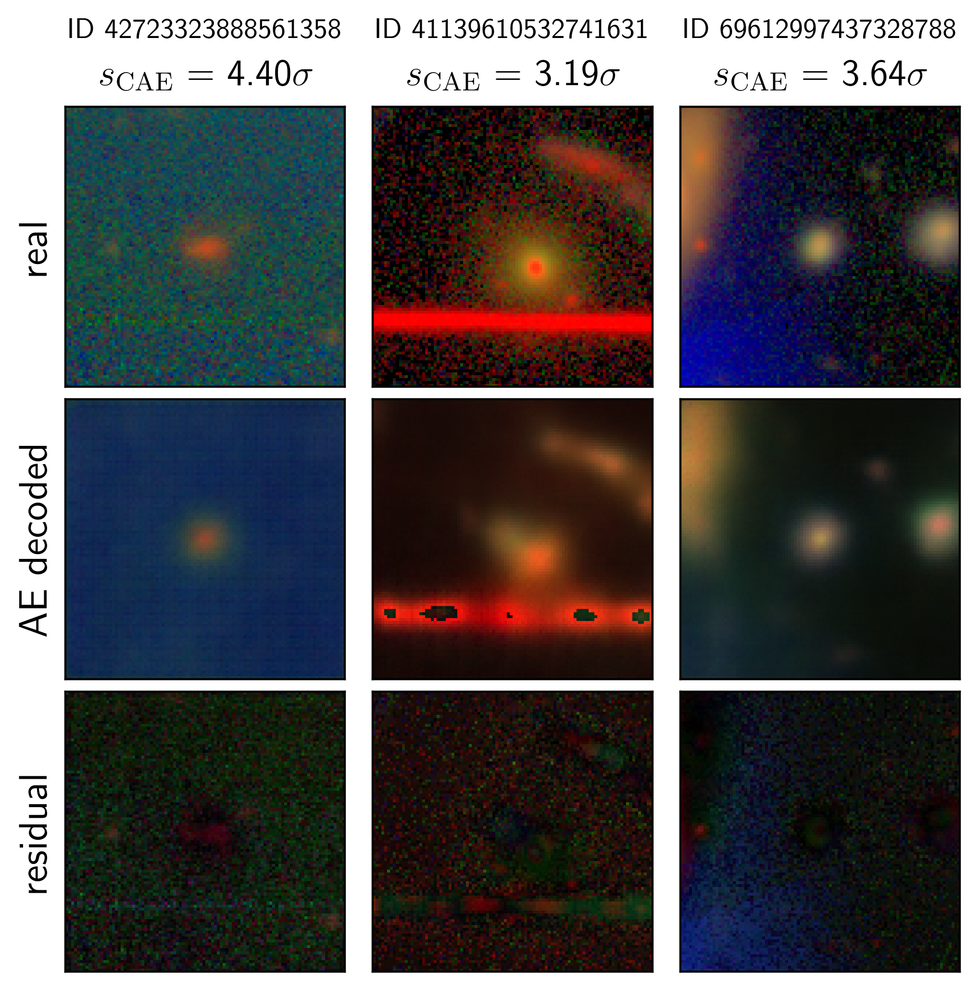

In [11]:
smin, smax = 5, 20
np.random.seed(43) #41
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plot_ae_recons(idxs_recon, aeres, saveto=f'{plot_dir}/recons_ae_{smin}to{smax}sigcomb.png',
                    score_name='ae_anomaly_scores_sigma', score_label='$s_\mathrm{{CAE}}$')

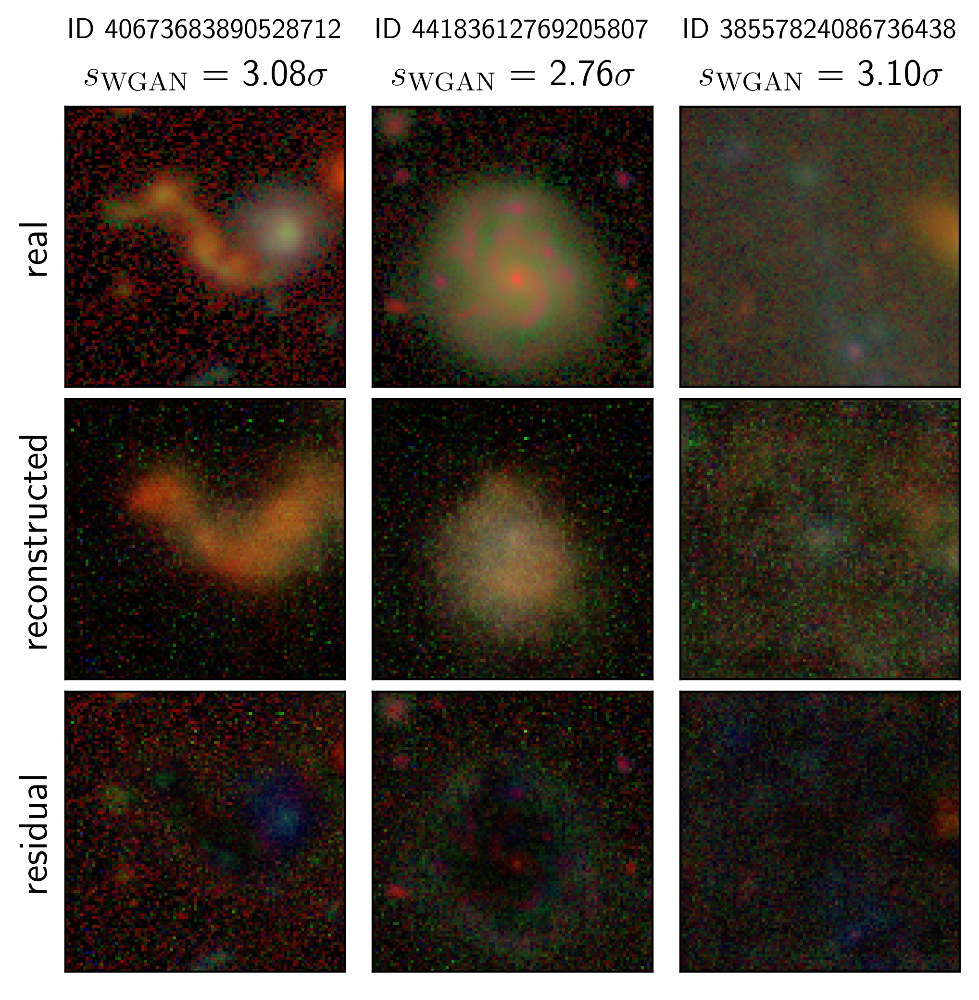

In [12]:
smin, smax = 2.5, 3.5
np.random.seed(42)
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plot_recons(idxs_recon, res, saveto=f'{plot_dir}/recons_{smin}to{smax}sigcomb.png',
                    score_name='anomaly_scores_sigma', score_label='$s_\mathrm{{WGAN}}$')

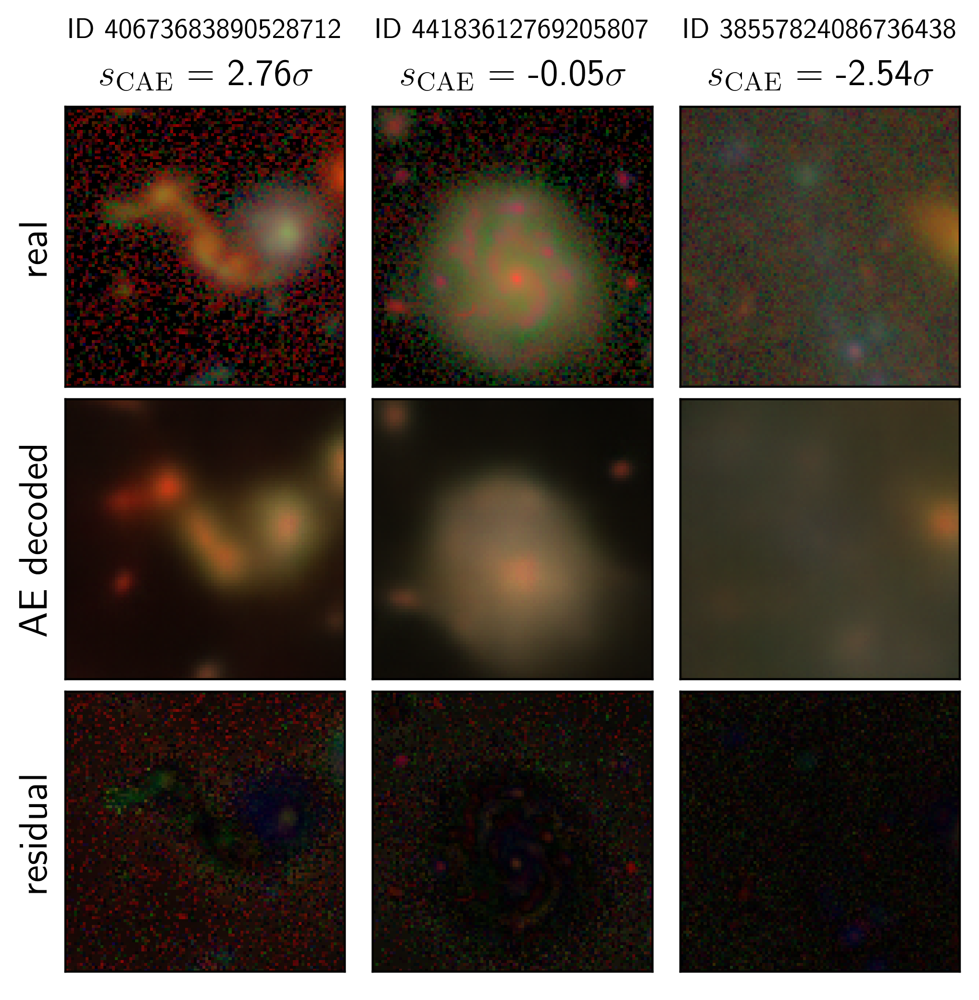

In [13]:
smin, smax = 2.5, 3.5
np.random.seed(42)
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plot_ae_recons(idxs_recon, aeres, saveto=f'{plot_dir}/recons_ae_{smin}to{smax}sigcomb.png',
                    score_name='ae_anomaly_scores_sigma', score_label='$s_\mathrm{{CAE}}$')

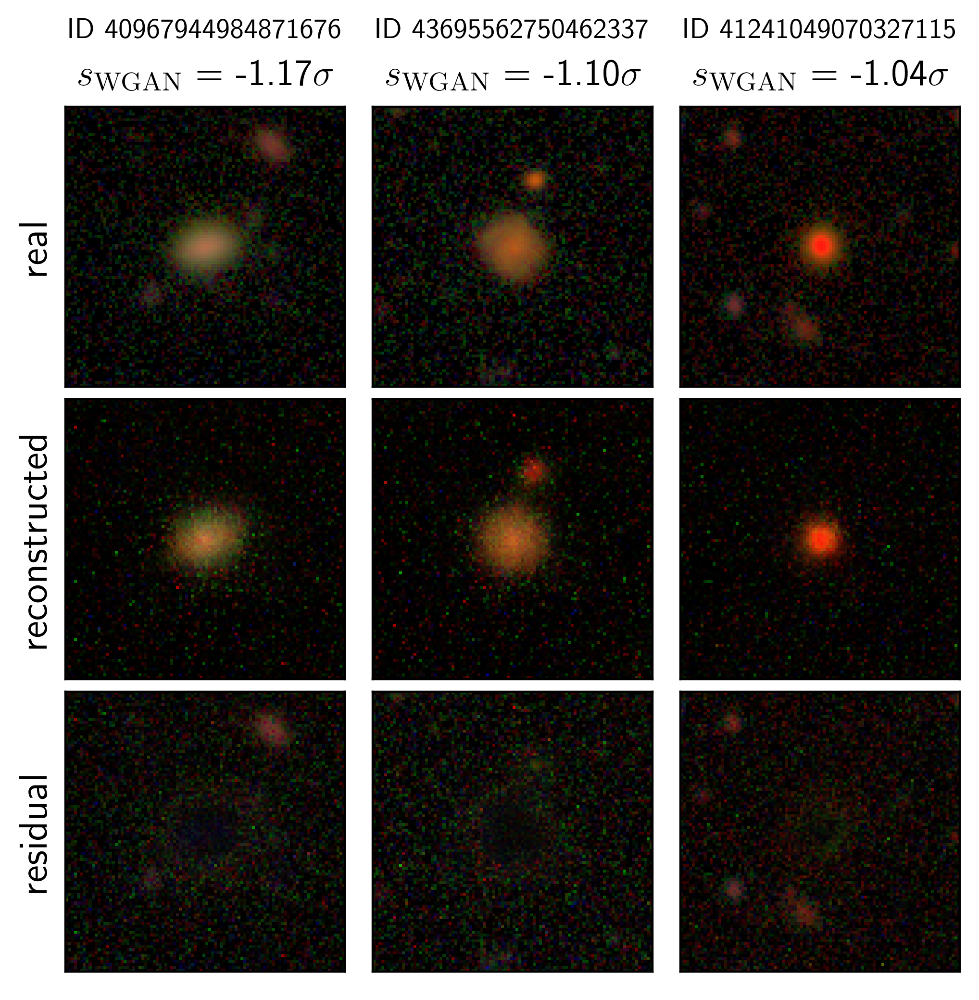

In [14]:
smin, smax = -3, -1
np.random.seed(41)
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plot_recons(idxs_recon, res, saveto=f'{plot_dir}/recons_{smin}to{smax}sigcomb.png',
                    score_name='anomaly_scores_sigma', score_label='$s_\mathrm{{WGAN}}$')

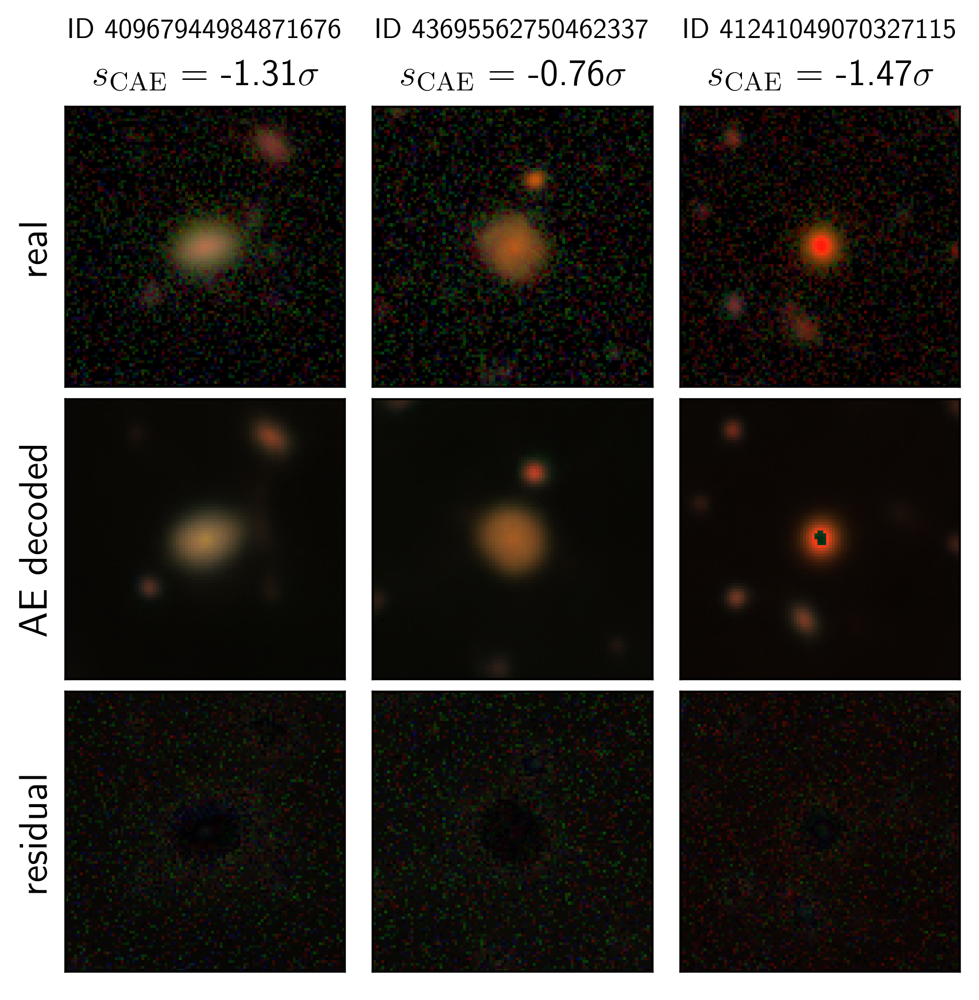

In [15]:
smin, smax = -3, -1
np.random.seed(41)
indices = np.where((scores >= smin) & (scores < smax))[0]
indices_n = np.random.choice(indices, n_recons)
idxs_recon = idxs[indices_n]
plot_ae_recons(idxs_recon, aeres, saveto=f'{plot_dir}/recons_ae_{smin}to{smax}sigcomb.png',
                    score_name='ae_anomaly_scores_sigma', score_label='$s_\mathrm{{CAE}}$')

### Look at CAE 3sig sample

In [16]:
def plot_ims(ids, nrows, ncols, saveto=None, headers=None, tight=False):
    assert len(ids)<=nrows*ncols, "bad rows/cols for number of ids!"
        
    subsize = 2
    fig, axarr = plt.subplots(nrows,ncols,figsize=(ncols*subsize,nrows*subsize))
    if tight:
        plt.subplots_adjust(hspace=0.03, wspace=-0.15)
    else:
        plt.subplots_adjust(hspace=0.2, wspace=0.05)
    plt.rc('text', usetex=True)
    
    count = 0
    for i in range(nrows):
        for j in range(ncols):
            idx = ids[count]
            loc = idx2imloc[idx]
            im = imarr['images'][loc]
            obj_id = int(imarr['object_ids'][loc])
            if nrows==1 and ncols==1:
                ax = axarr
            elif nrows==1:
                ax = axarr[j]
            elif ncols==1:
                ax = axarr[i]
            else:
                ax = axarr[i][j]
                
            if not tight:
                title = f"ID: {obj_id}"
                ax.set_title(title, fontsize=8)
            
            ax.imshow(utils.luptonize(im))
            ax.set_xticks([])
            ax.set_yticks([])
            
            if headers is not None and i==0:
                # units are pixel values;
                nside = 96
                ax.text(nside/2,-nside/4,headers[j], size=16, horizontalalignment='center')
                
            count += 1
            if count>=len(ids):
                break
                
        if count>=len(ids):
            break
                
    if saveto:
        plt.savefig(saveto, bbox_inches='tight')#, pad_inches=0)

In [17]:
nrows = 4
ncols = 8
nplot = nrows*ncols

In [18]:
idxs = aeres['idxs'][:]

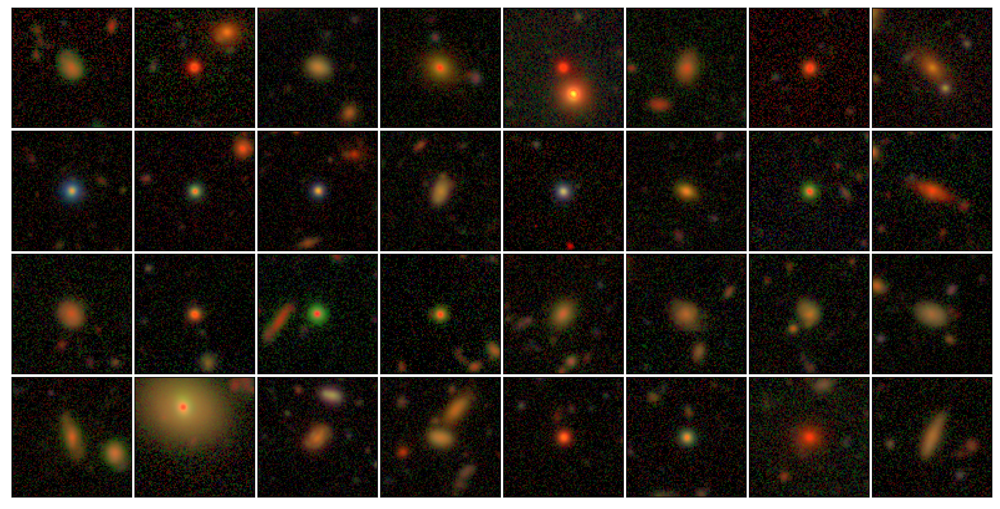

In [19]:
# 1.5 sig disc 
np.random.seed(42)
idxs_sub = np.random.choice(idxs, nplot, replace=False)
plot_ims(idxs_sub, nrows, ncols, tight=True)

8406


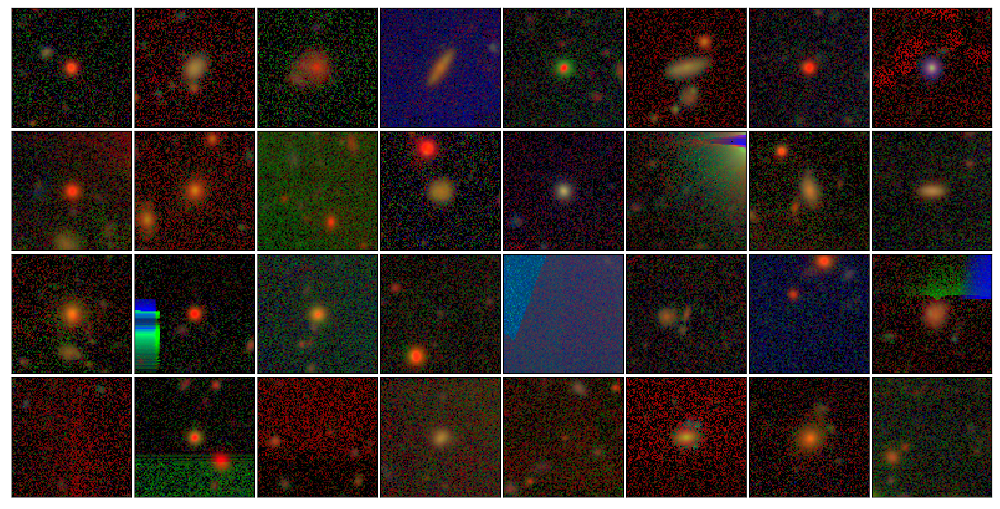

In [20]:
# 1.5 sig disc 
np.random.seed(42)
locs = np.where((aeres['ae_anomaly_scores_sigma'][:] > 3))[0]
print(len(locs))
idxs_sub = [idxs[loc] for loc in locs]
idxs_sub = np.random.choice(idxs_sub, nplot, replace=False)
plot_ims(idxs_sub, nrows, ncols, tight=True)

## Compare distributions

NOTE: aeres and res are not guaranteed to be in the same order, but they are!! We are relying on this here.

In [21]:
ae_scores_sigma = aeres['ae_anomaly_scores_sigma']
wgan_scores_sigma = res['anomaly_scores_sigma']
disc_scores_sigma = res['disc_scores_sigma']
gen_scores_sigma = res['gen_scores_sigma']

ae_scores = aeres['ae_anomaly_scores']
wgan_scores = res['anomaly_scores']
disc_scores = res['disc_scores']
gen_scores = res['gen_scores']

In [22]:
def plot_anomaly_dist_sigma(scores1, scores2, xscore_label, yscore_label, 
                            title=None, saveto=None):
    
    minmin = min(min(scores1), min(scores2))
    maxmax = max(max(scores1), max(scores2))
    bins = np.linspace(minmin, maxmax, 200)

    fig, axarr = plt.subplots(1, 2, figsize=(13, 5), gridspec_kw={'width_ratios': [1, 1.5]})
    plt.subplots_adjust(wspace=0)

    fig.suptitle(title)

    ax0 = axarr[0]
    b = ax0.hist(scores1, bins=bins, alpha=1, color='purple', label=f'total \nscore $(s_\mathrm{{{xscore_label}}})$', histtype='step', lw=1.5)
    b = ax0.hist(scores2, bins=bins, alpha=1, color='forestgreen', label=f'total \nscore $(s_\mathrm{{{yscore_label}}})$', histtype='step', lw=1.5)

    ax0.legend()
    ax0.set_xlabel(r"score ($\sigma$)")
    ax0.set_ylabel("number")
    ax0.set_xlim(-2, 5)


    ax1 = axarr[1]
    scat = ax1.scatter(scores1, scores2, s=1, c='k', alpha=0.2)

    smin, smax = -5, 15
    xx = np.linspace(smin,smax,2)
    ax1.plot(xx, xx, color='k', ls='--', lw=0.5)

    xscore_label_full = xscore_label
    yscore_label_full = yscore_label
    if xscore_label=='gen':
        xscore_label_full = 'generator'
    if yscore_label=='gen':
        yscore_label_full = 'generator'
    ax1.set_xlabel(fr"$s_\mathrm{{{xscore_label}}}$, {{{xscore_label_full}}} anomaly score")
    ax1.set_ylabel(fr"$s_\mathrm{{{yscore_label}}}$, {{{yscore_label_full}}} anomaly score")

    ax1.set_xlim(smin,smax)
    ax1.set_ylim(smin, smax)
    ticks = np.arange(smin, smax+5, 5)
    ax1.set_xticks(ticks)
    ax1.set_yticks(ticks)
    ax1.set_aspect('equal', adjustable='box')

    plt.show()
    if saveto:
        plt.savefig(saveto, bbox_inches='tight')

In [23]:
def plot_anomaly_dist(scores1, scores2, xscore_label, yscore_label,
                      title=None, saveto=None, smin=None, smax=None,
                      colorby=None, colorscore_label=None):
    
    minmin = min(min(scores1), min(scores2))
    maxmax = max(max(scores1), max(scores2))
    bins = np.linspace(minmin, maxmax, 200)

    fig, axarr = plt.subplots(1, 2, figsize=(13, 5), gridspec_kw={'width_ratios': [1, 1.5]})
    plt.subplots_adjust(wspace=0)

    fig.suptitle(title)

    full_label_dict = {'gen': 'generator',
                       'disc': 'discriminator',
                       'WGAN': 'WGAN',
                       'CAE': 'CAE'}
    ax0 = axarr[0]
    b = ax0.hist(scores1, bins=bins, alpha=1, color='blue', ls=':', label=f'{full_label_dict[xscore_label]} \nscore $(s_\mathrm{{{xscore_label}}})$', histtype='step', lw=1.5)
    b = ax0.hist(scores2, bins=bins, alpha=1, color='forestgreen', ls='-.', label=f'{full_label_dict[yscore_label]} \nscore $(s_\mathrm{{{yscore_label}}})$', histtype='step', lw=1.5)

    ax0.legend()
    ax0.set_xlabel(r"score (raw)")
    ax0.set_ylabel("number")
    ax0.set_xlim(smin, smax)

    ax1 = axarr[1]

    if smin is None:
        smin = minmin
    if smax is None:
        smax = maxmax
        
    if colorby is not None:
        scat = ax1.scatter(scores1, scores2, s=1, c=colorby, alpha=0.2, cmap='plasma_r', vmin=-2, vmax=5)
        cbar = fig.colorbar(scat, extend='max', ax=ax1)
        cbar.set_label(fr'$s_\mathrm{{{colorscore_label}}}$ ($\sigma$)', rotation=270, labelpad=8)
        cbar.set_alpha(1)
        cbar.draw_all()
    else:
        scat = ax1.scatter(scores1, scores2, s=1, c='k', alpha=0.2)

    ax1.set_xlabel(f"$s_\mathrm{{{xscore_label}}}$, {full_label_dict[xscore_label]} score (raw)")
    ax1.set_ylabel(fr"$s_\mathrm{{{yscore_label}}}$, {full_label_dict[yscore_label]} score (raw)")

    smin_ax1 = 0
    smax_ax1 = smax*1.7
    xx = np.linspace(smin_ax1,smax_ax1,2)
    ax1.plot(xx, xx, color='k', ls='--', lw=0.5)
    ax1.set_xlim(smin_ax1, smax_ax1)
    ax1.set_ylim(smin_ax1, smax_ax1)
    
    ax1.set_aspect('equal', adjustable='box')

    if saveto:
        plt.savefig(saveto, bbox_inches='tight')

In [24]:
print(np.median(gen_scores[:]), np.median(ae_scores[:]))
print(np.mean(gen_scores[:]), np.mean(ae_scores[:]))

1527.8364 1405.9968
1570.7557 1429.6614


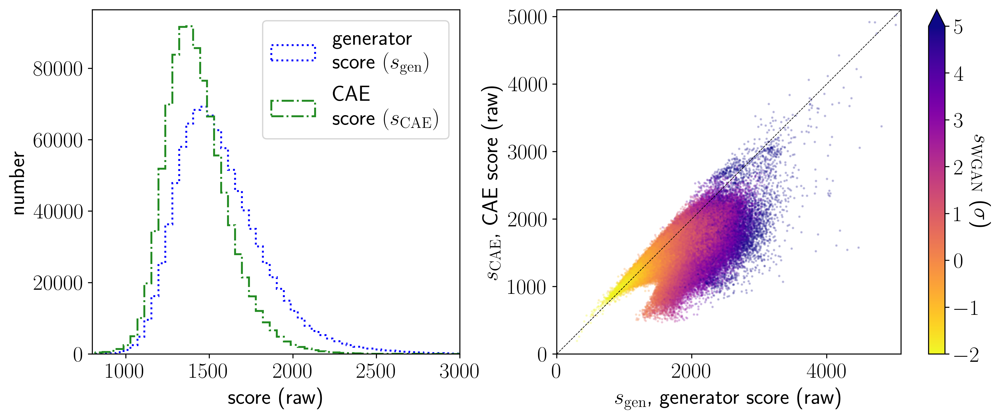

In [25]:
saveto = f'{plot_dir}/score_distribution_ae.png'
plot_anomaly_dist(gen_scores[:], ae_scores[:], 'gen', 'CAE', smin=800, smax=3000, 
                  colorby=wgan_scores_sigma[:], colorscore_label='WGAN',
                  saveto=saveto)

## Sample figure

In [26]:
def plot_ims_tight(ax_grid, ids, nrows, ncols):
    NSIDE = 96
    NBANDS = 3
    imgrid = np.empty((nrows*NSIDE, ncols*NSIDE, NBANDS))
    count = 0
    for i in range(nrows):
        for j in range(ncols):
            idx = ids[count]
            loc = idx2imloc[idx]
            im = imarr['images'][loc]
            im = utils.luptonize(im)
            
            imgrid[i*NSIDE:(i+1)*NSIDE, j*NSIDE:(j+1)*NSIDE, :] = im
            count += 1
    imgrid = imgrid.astype('int32')
    ax_grid.imshow(imgrid)

In [27]:
nrows = 6
ncols = 6
nplot = nrows*ncols

nrows_small = 3
ncols_small = 3
nplot_small = nrows_small*ncols_small

In [28]:
mask_ae = aeres['ae_anomaly_scores_sigma'][:] > 3
mask_disc = res['disc_scores_sigma'][:] > 3
mask_gen = res['gen_scores_sigma'][:] > 3
mask_comb = res['anomaly_scores_sigma'][:] > 3

In [29]:
idxs_ae_3sig = aeres['idxs'][mask_ae]
idxs_ae_lowd_3sig = aeres['idxs'][mask_ae & ~mask_disc]
idxs_ae_lowg_3sig = aeres['idxs'][mask_ae & ~mask_gen]

idxs_gen_3sig = aeres['idxs'][mask_gen]
idxs_gen_lowc_3sig = aeres['idxs'][mask_gen & ~mask_ae]
idxs_gen_lowd_3sig = aeres['idxs'][mask_gen & ~mask_disc]

idxs_disc_3sig = aeres['idxs'][mask_disc]
idxs_disc_lowc_3sig = aeres['idxs'][mask_disc & ~mask_ae]
idxs_disc_lowg_3sig = aeres['idxs'][mask_disc & ~mask_gen]

In [30]:
np.random.seed(8) # 8

idxs_ae = np.random.choice(idxs_ae_3sig, nplot, replace=False)
idxs_ae_lowd = np.random.choice(idxs_ae_lowd_3sig, nplot, replace=False)
idxs_ae_lowg = np.random.choice(idxs_ae_lowg_3sig, nplot, replace=False)

idxs_gen = np.random.choice(idxs_gen_3sig, nplot, replace=False)
idxs_gen_lowc = np.random.choice(idxs_gen_lowc_3sig, nplot, replace=False)
idxs_gen_lowd = np.random.choice(idxs_gen_lowd_3sig, nplot, replace=False)

idxs_disc = np.random.choice(idxs_disc_3sig, nplot, replace=False)
idxs_disc_lowc = np.random.choice(idxs_disc_lowc_3sig, nplot, replace=False)
idxs_disc_lowg = np.random.choice(idxs_disc_lowg_3sig, nplot, replace=False)

In [31]:
# Labels
lf = 'Full sample'
lc = '$s_\mathrm{CAE} > 3\sigma$'
ld = '$s_\mathrm{disc} > 3\sigma$'
lg = '$s_\mathrm{gen} > 3\sigma$'

lcl = '$s_\mathrm{CAE} < 3\sigma$'
ldl = '$s_\mathrm{disc} < 3\sigma$'
lgl = '$s_\mathrm{gen} < 3\sigma$'

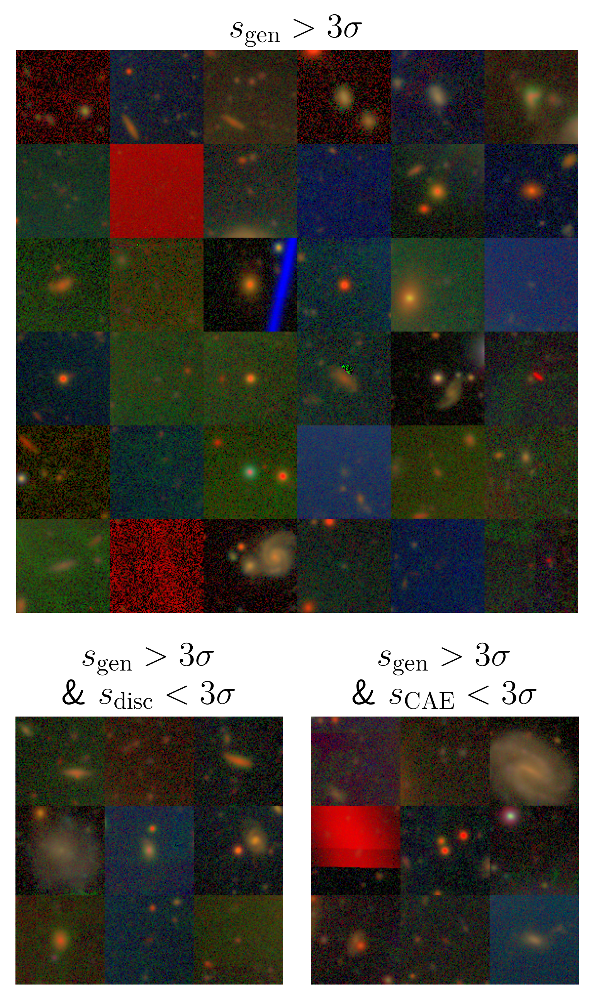

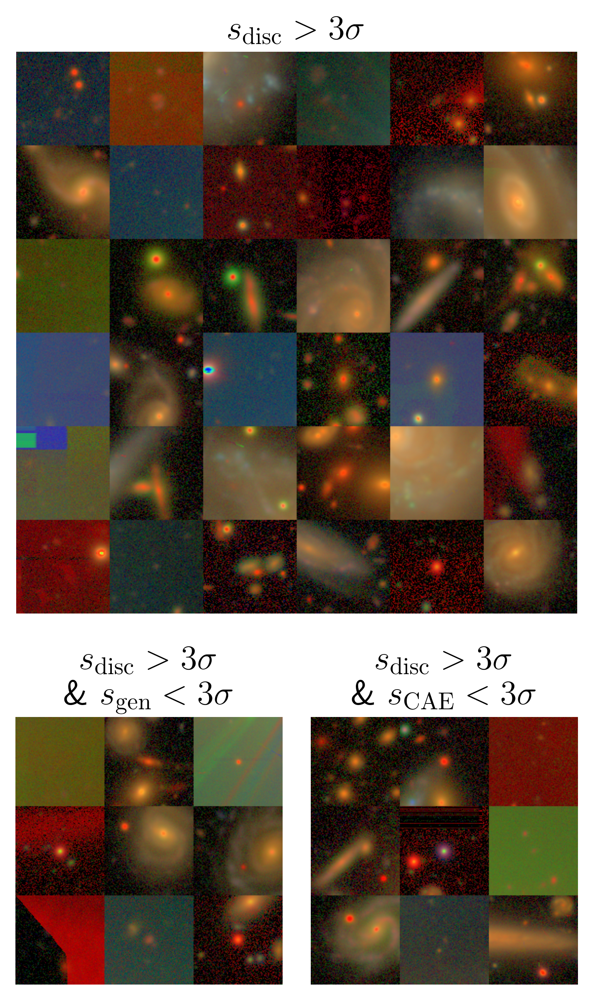

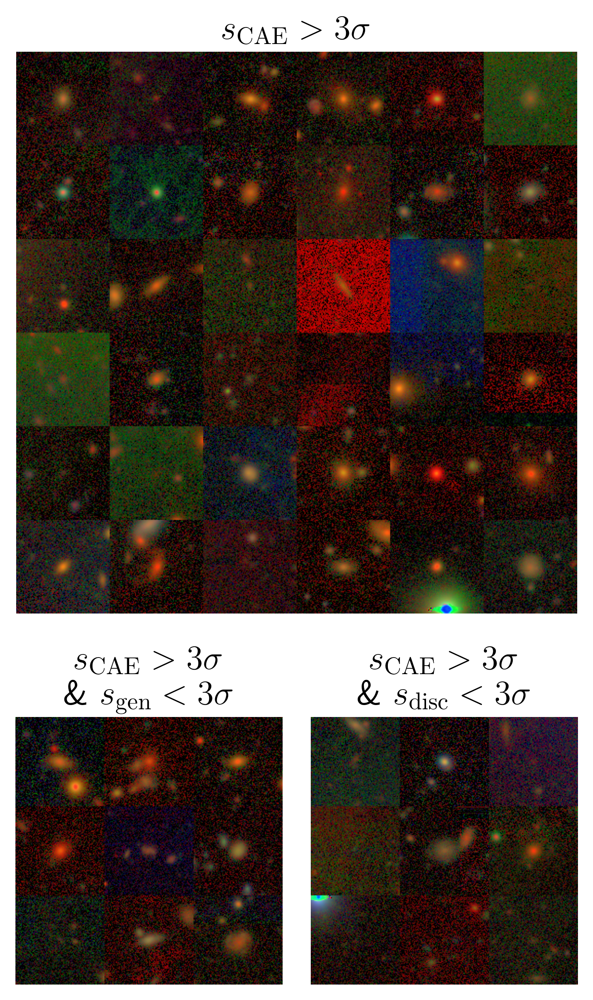

In [32]:
fs_title = 16

### s_gen panels
saveto = f'{plot_dir}/score_effect_gen_ae.png'
fig = plt.figure(constrained_layout=False, figsize=(6,8))
gs = fig.add_gridspec(2, 2, wspace=-0.3, hspace=0.25, height_ratios=[2.1,1])

ax2 = fig.add_subplot(gs[0, :])
ax2a = fig.add_subplot(gs[1, 0])
ax2b = fig.add_subplot(gs[1, 1])

plot_ims_tight(ax2, idxs_gen, nrows, ncols)
plot_ims_tight(ax2a, idxs_gen_lowd, nrows_small, ncols_small)
plot_ims_tight(ax2b, idxs_gen_lowc, nrows_small, ncols_small)

ax2.set_title(lg, fontsize=fs_title)
ax2a.set_title(f'{lg}\n\& {ldl}', fontsize=fs_title)
ax2b.set_title(f'{lg}\n\& {lcl}', fontsize=fs_title)

# turn off all axes
for ax in fig.get_axes():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("off")
plt.savefig(saveto, bbox_inches='tight')


### s_disc panels
saveto = f'{plot_dir}/score_effect_disc_ae.png'
fig = plt.figure(constrained_layout=False, figsize=(6,8))
gs = fig.add_gridspec(2, 2, wspace=-0.3, hspace=0.25, height_ratios=[2.1,1])

ax1 = fig.add_subplot(gs[0, :])
ax1a = fig.add_subplot(gs[1, 0])
ax1b = fig.add_subplot(gs[1, 1])

plot_ims_tight(ax1, idxs_disc, nrows, ncols)
plot_ims_tight(ax1a, idxs_disc_lowg, nrows_small, ncols_small)
plot_ims_tight(ax1b, idxs_disc_lowc, nrows_small, ncols_small)

ax1.set_title(ld, fontsize=fs_title)
ax1a.set_title(f'{ld}\n\& {lgl}', fontsize=fs_title)
ax1b.set_title(f'{ld}\n\& {lcl}', fontsize=fs_title)

# turn off all axes
for ax in fig.get_axes():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("off")
plt.savefig(saveto, bbox_inches='tight')


### s_cae panels
saveto = f'{plot_dir}/score_effect_ae.png'
fig = plt.figure(constrained_layout=False, figsize=(6,8))
gs = fig.add_gridspec(2, 2, wspace=-0.3, hspace=0.25, height_ratios=[2.1,1])

ax0 = fig.add_subplot(gs[0, :])
ax0a = fig.add_subplot(gs[1, 0])
ax0b = fig.add_subplot(gs[1, 1])

plot_ims_tight(ax0, idxs_ae, nrows, ncols)
plot_ims_tight(ax0a, idxs_ae_lowg, nrows_small, ncols_small)
plot_ims_tight(ax0b, idxs_ae_lowd, nrows_small, ncols_small)

ax0.set_title(lc, fontsize=fs_title)
ax0a.set_title(f'{{{lc}}}\n\& {{{lgl}}}', fontsize=fs_title)
ax0b.set_title(f'{{{lc}}}\n\& {{{ldl}}}', fontsize=fs_title)

# turn off all axes
for ax in fig.get_axes():
    ax.set_xticks([])
    ax.set_yticks([])
    ax.axis("off")
plt.savefig(saveto, bbox_inches='tight')

## detected anomalies

In [33]:
purple_ids = [631495, 60339, 105685, 80217, 378977, 355424, 690942, 726364, 477930]
bluesf_ids = [461525, 461522, 702705, 402208, 86279, 27054, 207619, 461523, 554045] #54348 something close to that
tidal_ids = [406992,232476,402855,112806, 771116, 116299, 193323, 357136, 734970] #390040, 526030
merger_ids = [147100,105162, 609137,275917, 273903, 331753, 476493, 516719, 864590]  #402153
unknown_ids = [404340, 402594, 822595, 372063, 732308, 604860] #66001
bluecore_ids = [941128, 782291, 490258] #585702, 494887
anomaly_id_lists = [purple_ids, bluesf_ids, tidal_ids, merger_ids, unknown_ids, bluecore_ids]
print("n total:", len(np.concatenate(anomaly_id_lists).flatten()))

n total: 45


In [34]:
count = 0
for i, id_list in enumerate(anomaly_id_lists):
    print("List", i)
    for idx in id_list:
        if idx in idxs_ae_3sig:
            print(f"idx {idx} in CAE 3sig!")
            count += 1
print(f"Count: {count} found total")

List 0
List 1
List 2
idx 402855 in CAE 3sig!
List 3
List 4
idx 402594 in CAE 3sig!
List 5
Count: 2 found total


In [35]:
count = 0
for i, id_list in enumerate(anomaly_id_lists):
    print("List", i)
    for idx in id_list:
        if idx in idxs_gen_3sig:
            print(f"idx {idx} in gen 3sig!")    
            count += 1
print(f"Count: {count} found total")

List 0
idx 60339 in gen 3sig!
idx 355424 in gen 3sig!
List 1
idx 461525 in gen 3sig!
idx 461522 in gen 3sig!
idx 702705 in gen 3sig!
List 2
idx 406992 in gen 3sig!
idx 402855 in gen 3sig!
idx 112806 in gen 3sig!
idx 193323 in gen 3sig!
List 3
idx 105162 in gen 3sig!
List 4
idx 732308 in gen 3sig!
List 5
Count: 11 found total


In [36]:
count = 0
for i, id_list in enumerate(anomaly_id_lists):
    print("List", i)
    for idx in id_list:
        if idx in idxs_disc_3sig:
            print(f"idx {idx} in disc 3sig!")
            count += 1
print(f"Count: {count} found total")

List 0
idx 631495 in disc 3sig!
idx 60339 in disc 3sig!
idx 105685 in disc 3sig!
idx 80217 in disc 3sig!
idx 378977 in disc 3sig!
idx 355424 in disc 3sig!
idx 690942 in disc 3sig!
idx 726364 in disc 3sig!
idx 477930 in disc 3sig!
List 1
idx 461525 in disc 3sig!
idx 461522 in disc 3sig!
idx 702705 in disc 3sig!
idx 402208 in disc 3sig!
idx 86279 in disc 3sig!
idx 27054 in disc 3sig!
idx 207619 in disc 3sig!
idx 461523 in disc 3sig!
idx 554045 in disc 3sig!
List 2
idx 406992 in disc 3sig!
idx 232476 in disc 3sig!
idx 402855 in disc 3sig!
idx 112806 in disc 3sig!
idx 771116 in disc 3sig!
idx 116299 in disc 3sig!
idx 193323 in disc 3sig!
idx 357136 in disc 3sig!
idx 734970 in disc 3sig!
List 3
idx 147100 in disc 3sig!
idx 105162 in disc 3sig!
idx 609137 in disc 3sig!
idx 275917 in disc 3sig!
idx 273903 in disc 3sig!
idx 331753 in disc 3sig!
idx 476493 in disc 3sig!
idx 516719 in disc 3sig!
idx 864590 in disc 3sig!
List 4
idx 404340 in disc 3sig!
idx 402594 in disc 3sig!
idx 822595 in disc 

## HSC catalog data figure

In [37]:
anom_file = '/scratch/ksf293/anomalies/data/hsc_catalogs/anomaly_catalog_hsc_full_ae.fits'
anom_cat = Table.read(anom_file)

In [38]:
def plot_histogram(ax, quantity_name, anom_cats, colors, labels, linestyles, legend=False, legend_loc='upper right'):
    
    histtype='step'
    lw=1.5
    
    if 'blendedness' in quantity_name:
        bins = 12
        yfac = 1.0
        thresh = 10**-0.375
        ax.axvline(thresh, lw=0.7, color='grey')
    else:
        bins = 30
        yfac = 1.4
    
    for i, cat in enumerate(anom_cats):
        vals = cat[quantity_name] 

        ax.hist(vals, lw=lw, histtype=histtype, bins=bins, density=True, range=range_dict[quantity_name], 
                 color=colors[i], label=labels[i], ls=linestyles[i], alpha=alpha)

    ax.set_xlabel(xlabel_dict[quantity_name])
    ax.set_ylabel('normalized counts')
    
    ax.set_xlim(range_dict[quantity_name])
    ylim = ax.get_ylim()
    ax.set_ylim(ylim[0], yfac*ylim[1])
    ax.yaxis.set_major_formatter(FormatStrFormatter('%.1f'))
    
    if legend:
        ax.legend(loc=legend_loc)

In [39]:
range_dict = {
                'gr_color_cmod': (-0.8, 2.9),
                'ri_color_cmod': (-0.8, 2.9),
                'r_aperature_ratio': (-2, 0.5),
                'i_aperature_ratio': (-2, 0.5),
                'i_cmodel_exp_ellipse_logr': (-0.2, 1.2),#(-0.5, 1.5),
                'i_cmodel_exp_ellipse_e': (0, 1),
                'i_blendedness_abs_flux': (0.0, 1),
             }
xlabel_dict = {
                'gr_color_cmod': r'$g-r$ color',
                'ri_color_cmod': r'$r-i$ color',
                'r_aperature_ratio': r'$\log_{10} (r_{\rm Aper}/r_{\rm CModel})$',
                'i_aperature_ratio': r'$\log_{10} (i_{\rm Aper}/i_{\rm CModel})$',
                'i_cmodel_exp_ellipse_logr': r'$\log_{10} (R_{\rm eff} \; [\mathrm{arcsec}])$', 
                'i_cmodel_exp_ellipse_e': r'ellipticity',
                'i_blendedness_abs_flux': 'blendedness',
               }

In [40]:
#colors
cmap = matplotlib.cm.get_cmap('plasma_r')
cf = cmap(0.25)
cc = 'forestgreen'
cd = 'red'
cg = 'blue'
alpha = 0.9

# Labels
lf = 'Full sample'
lc = r'$s_\mathrm{CAE} > 3\sigma$'
ld = r'$s_\mathrm{disc} > 3\sigma$'
lg = r'$s_\mathrm{gen} > 3\sigma$'

# line styles 
lsf = '-'
lsc = '-.'
lsd = '--'
lsg = ':'

In [41]:
mask_disc = anom_cat['discriminator_score_normalized'] > 3
mask_gen = anom_cat['generator_score_normalized'] > 3
mask_ae = anom_cat['ae_score_normalized'] > 3

anom_gen = anom_cat[mask_gen]
anom_disc = anom_cat[mask_disc]

anom_ae = anom_cat[mask_ae]
anom_full = anom_cat

In [42]:
anom_cats = [anom_full, anom_ae, anom_gen, anom_disc]
anom_colors = [cf, cc, cg, cd]
anom_labels = [lf, lc, lg, ld]
anom_lss = [lsf, lsc, lsg, lsd]

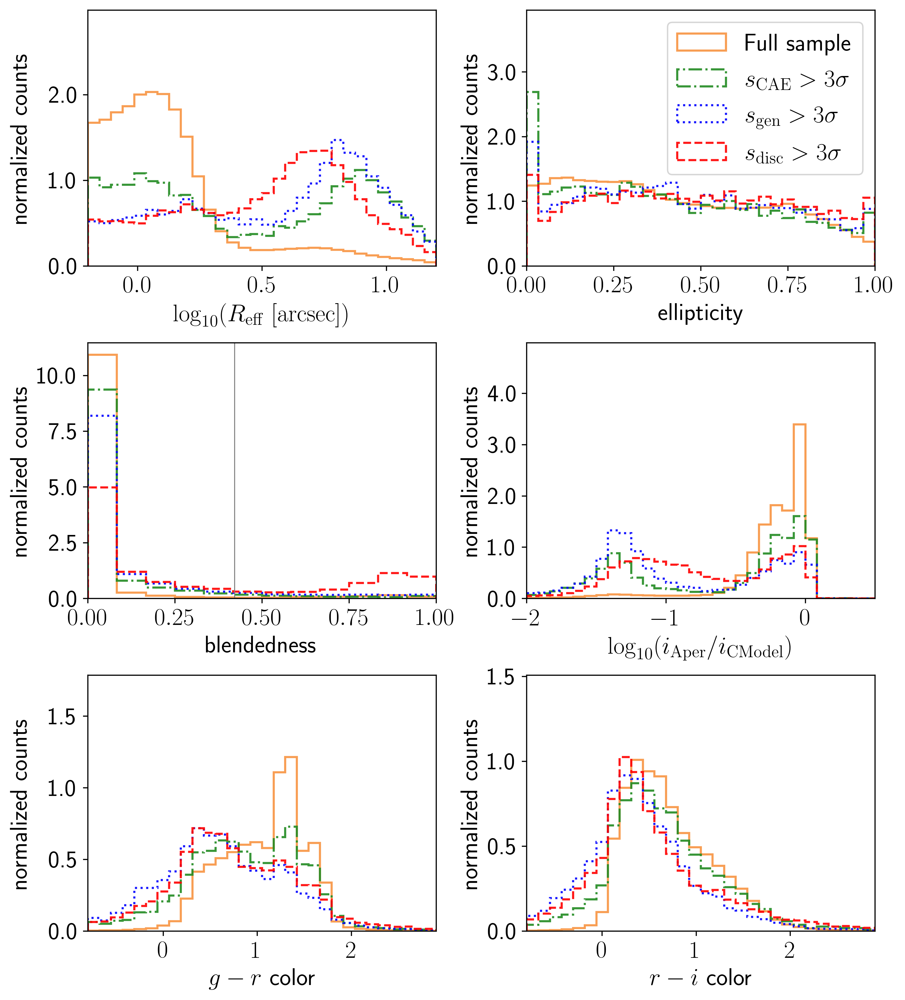

In [43]:
nrows = 3
ncols = 2

saveto = f'{plot_dir}/hsc_histograms_ae.png'
fig, axarr = plt.subplots(nrows, ncols, figsize=(5*ncols, 4*nrows))
#plt.subplots_adjust(hspace=0.22, wspace=0.22)
plt.subplots_adjust(hspace=0.3, wspace=0.26)

plot_histogram(axarr[0][0], 'i_cmodel_exp_ellipse_logr', anom_cats, anom_colors, anom_labels, anom_lss)
plot_histogram(axarr[0][1], 'i_cmodel_exp_ellipse_e', anom_cats, anom_colors, anom_labels, anom_lss, legend=True)

plot_histogram(axarr[1][0], 'i_blendedness_abs_flux', anom_cats, anom_colors, anom_labels, anom_lss)
plot_histogram(axarr[1][1], 'i_aperature_ratio', anom_cats, anom_colors, anom_labels, anom_lss)

plot_histogram(axarr[2][0], 'gr_color_cmod', anom_cats, anom_colors, anom_labels, anom_lss)
plot_histogram(axarr[2][1], 'ri_color_cmod', anom_cats, anom_colors, anom_labels, anom_lss)

fig.align_ylabels()

plt.savefig(saveto, bbox_inches='tight')

In [44]:
print(f"median full log(reff): {np.nanmedian(anom_cat['i_cmodel_exp_ellipse_logr'])}")
print(f"median full reff: {10**np.nanmedian(anom_cat['i_cmodel_exp_ellipse_logr'])}")
print(f"median disc log(reff): {np.nanmedian(anom_disc['i_cmodel_exp_ellipse_logr'])}")
print(f"median disc reff: {10**np.nanmedian(anom_disc['i_cmodel_exp_ellipse_logr'])}")

median full log(reff): -0.27107595194491685
median full reff: 0.5357029624708081
median disc log(reff): 0.39688787549049376
median disc reff: 2.493950765026977


In [45]:
blend_mask_full = np.where(anom_cat['i_blendedness_abs_flux']>10**(-0.375))[0]
blend_mask_disc = np.where(anom_disc['i_blendedness_abs_flux']>10**(-0.375))[0]
print(f"% full above blend thresh: {len(blend_mask_full)/len(anom_cat)}")
print(f"% disc above blend thresh: {len(blend_mask_disc)/len(anom_disc)}")

% full above blend thresh: 0.05264106934696393
% disc above blend thresh: 0.3738220672256437


In [46]:
aper_thresh = -1
aper_mask_full = np.where(anom_cat['i_aperature_ratio']<aper_thresh)[0]
aper_mask_disc = np.where(anom_disc['i_aperature_ratio']<aper_thresh)[0]
aper_mask_gen = np.where(anom_gen['i_aperature_ratio']<aper_thresh)[0]
aper_mask_ae = np.where(anom_ae['i_aperature_ratio']<aper_thresh)[0]
print(f"% full below aper thresh: {len(aper_mask_full)/len(anom_cat)}")
print(f"% disc below aper thresh: {len(aper_mask_disc)/len(anom_disc)}")
print(f"% gen below aper thresh: {len(aper_mask_gen)/len(anom_gen)}")
print(f"% ae below aper thresh: {len(aper_mask_ae)/len(anom_ae)}")


% full below aper thresh: 0.04777779781306581
% disc below aper thresh: 0.4009794464643467
% gen below aper thresh: 0.5610687022900763
% ae below aper thresh: 0.3648250677347155


## Replotting with s_WGAN

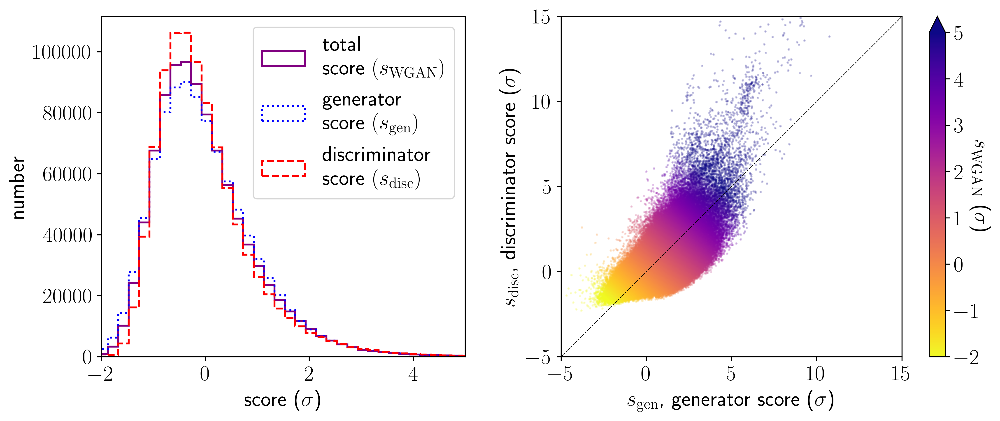

In [47]:
saveto = f'{plot_dir}/score_distribution.png'
plotter.plot_anomaly_dist(res['anomaly_scores_sigma'][:], res['gen_scores_sigma'][:], 
                          res['disc_scores_sigma'][:], saveto=saveto)

## Test region


In [48]:
# imtag = 'gri_lambda0.3_3sigd'
# tag = 'gri_lambda0.3_3sigd'
# aenum = 10000
imtag = 'gri_1k'
tag = 'gri_1k_lambda0.3'
aenum = 30000
# imtag = 'gri'
# tag = 'gri_lambda0.3'
# aenum = 30000
# mode = 'reals'
aetag = f'_latent64_{mode}_long_lr1e-4'
savetag = f'_model{aenum}{aetag}'
base_dir = '/scratch/ksf293/anomalies'
results_dir = f'{base_dir}/results'
results_ae_fn = f'{results_dir}/results_aefull_{tag}{savetag}.h5'
results_fn = f'{results_dir}/results_{tag}.h5'
#imarr_fn = f'{base_dir}/data/images_h5/images_{imtag}.h5'
aer = h5py.File(results_ae_fn, 'r')
rr = h5py.File(results_fn, 'r')

In [49]:
aer['ae_anomaly_scores'][:10]

array([1267.6476, 1299.1575, 1308.1506, 1314.1366, 1466.6947, 1398.8734,
       1242.7329, 1271.4789, 1388.2189, 1324.4883], dtype=float32)

In [50]:
results_aefull_fn = f'{results_dir}/results_aefull_{tag}{savetag}.h5'
aerf = h5py.File(results_aefull_fn, 'r')

In [51]:
aerf['ae_anomaly_scores'][:10]

array([1267.6476, 1299.1575, 1308.1506, 1314.1366, 1466.6947, 1398.8734,
       1242.7329, 1271.4789, 1388.2189, 1324.4883], dtype=float32)

In [52]:
rr['gen_scores'][:10]

array([1720.9552, 1266.1483, 1289.3657, 1589.1848, 1614.2772, 2057.5032,
       2287.0518, 1492.9797, 2023.6302, 1533.6904], dtype=float32)

In [53]:
aer['idxs'][:10]

array([228357, 564766, 417809, 394938, 171845, 816072, 732367, 306944,
       614643,  64014], dtype=uint32)

In [54]:
rr['idxs'][:10]

array([228357, 564766, 417809, 394938, 171845, 816072, 732367, 306944,
       614643,  64014], dtype=uint32)